In [1]:
# Import function to create training and test set splits
from sklearn.model_selection import train_test_split
# Import function to automatically create polynomial features! 
from sklearn.preprocessing import PolynomialFeatures
# Import Linear Regression
from sklearn.linear_model import LinearRegression
import pandas as pd
import matplotlib.pyplot as plt
# Import model_selection for cross validation
from sklearn import model_selection

from sklearn.metrics import r2_score, mean_absolute_error

import numpy as np
import pandas as pd

import warnings
warnings.filterwarnings("ignore")

### 1. Se pide:

A partir del archivo "USA_Housing.csv", realizar la regresión no lineal entre cada columna numérica con la columna 'price' utilizando:

- Regresión polinómica no lineal con grados del 2 al 10. ¿El score se estanca a partir de cierto grado?

In [2]:
import pandas as pd

df = pd.read_csv("../data/USA_Housing.csv")
df

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price,Address
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06,"208 Michael Ferry Apt. 674\r\nLaurabury, NE 37..."
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06,"188 Johnson Views Suite 079\r\nLake Kathleen, ..."
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06,"9127 Elizabeth Stravenue\r\nDanieltown, WI 064..."
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06,USS Barnett\r\nFPO AP 44820
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05,USNS Raymond\r\nFPO AE 09386
...,...,...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035,1.060194e+06,USNS Williams\r\nFPO AP 30153-7653
4996,78491.275435,6.999135,6.576763,4.02,25616.115489,1.482618e+06,"PSC 9258, Box 8489\r\nAPO AA 42991-3352"
4997,63390.686886,7.250591,4.805081,2.13,33266.145490,1.030730e+06,"4215 Tracy Garden Suite 076\r\nJoshualand, VA ..."
4998,68001.331235,5.534388,7.130144,5.44,42625.620156,1.198657e+06,USS Wallace\r\nFPO AE 73316


In [4]:
def non_linear_func(df):
    
    list_columns = df._get_numeric_data().columns.tolist()[:-1]
    
    for column in list_columns:
        
        X = df[[column]]

        # Test/train separación
        X_train, X_test, y_train, y_test = train_test_split(X.values, df["Price"].values, test_size=0.2)

        # Min and max grados a considerar
        degree_min = 2
        degree_max = 10

        scores = []
        for degree in range(degree_min,degree_max+1):
            print("-------------------------------------")
            print(column)
            polinominal_model = PolynomialFeatures(degree) 
            X_poly = polinominal_model.fit_transform(X_train.reshape(-1, 1),y_train)

            lin_reg_model = LinearRegression()
            lin_reg_model.fit(X_poly, y_train)
            y_pred = lin_reg_model.predict(X_poly)

            print("Train Score:", r2_score(y_train, y_pred))
            scores.append(r2_score(y_train, y_pred))
            print("MAE:", mean_absolute_error(y_true=y_train, y_pred=y_pred))
            X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train, y_train)))
            plt.scatter(X_train_to_show, y_train_to_show, color='g')

            X_train_to_show, y_pred = zip(*sorted(zip(X_train, y_pred)))
            plt.plot(X_train_to_show, y_pred, color='red')
            plt.title(column + " - Poninominal degree " + str(degree))
            plt.show()
        print(scores)


-------------------------------------
Avg. Area Income
Train Score: 0.40301161812867603
MAE: 218841.0688696044


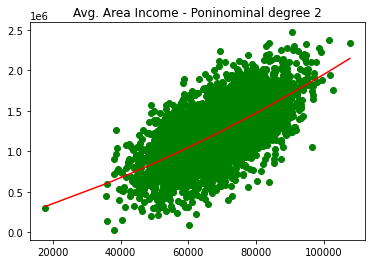

-------------------------------------
Avg. Area Income
Train Score: 0.40303836127123327
MAE: 218850.33802505975


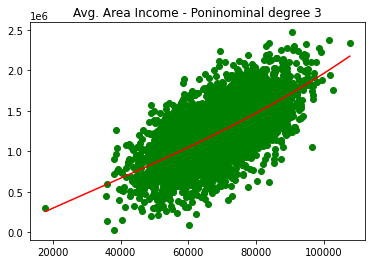

-------------------------------------
Avg. Area Income
Train Score: 0.4030772535659529
MAE: 218837.732143075


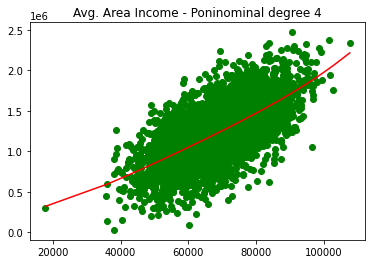

-------------------------------------
Avg. Area Income
Train Score: 0.40310009028607374
MAE: 218835.87459769644


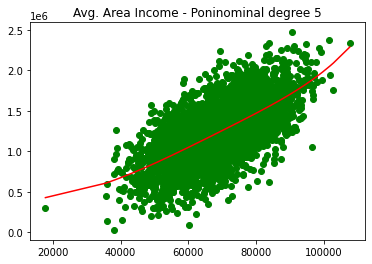

-------------------------------------
Avg. Area Income
Train Score: 0.4029774931339146
MAE: 218850.81581969708


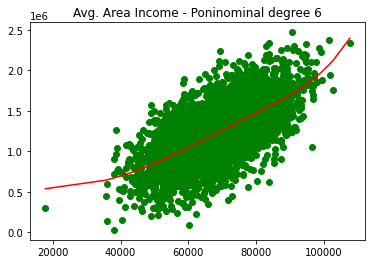

-------------------------------------
Avg. Area Income
Train Score: 0.4024411321294056
MAE: 218915.32557296747


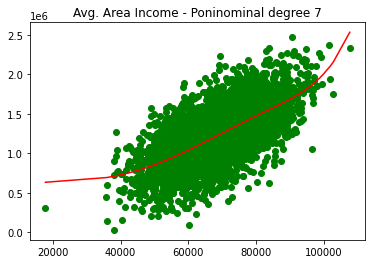

-------------------------------------
Avg. Area Income
Train Score: 0.4011045571911287
MAE: 219106.4472136298


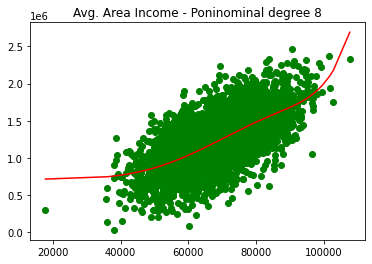

-------------------------------------
Avg. Area Income
Train Score: 0.3985645412415201
MAE: 219511.6738773936


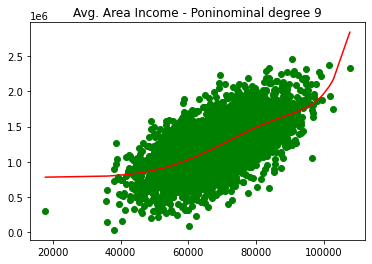

-------------------------------------
Avg. Area Income
Train Score: 0.39449898832203645
MAE: 220183.42697960598


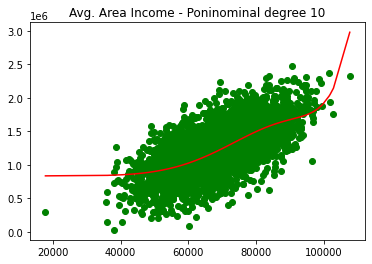

[0.40301161812867603, 0.40303836127123327, 0.4030772535659529, 0.40310009028607374, 0.4029774931339146, 0.4024411321294056, 0.4011045571911287, 0.3985645412415201, 0.39449898832203645]
-------------------------------------
Avg. Area House Age
Train Score: 0.19843096574897068
MAE: 250996.72962385518


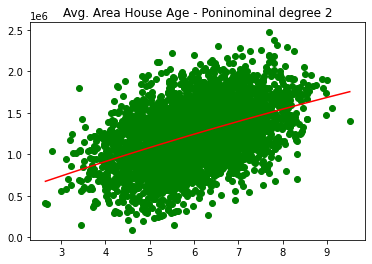

-------------------------------------
Avg. Area House Age
Train Score: 0.198788895071215
MAE: 251025.04416831565


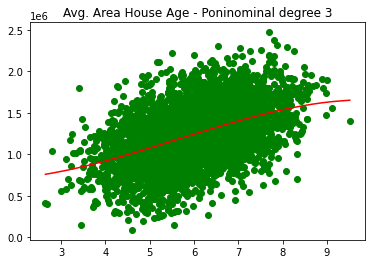

-------------------------------------
Avg. Area House Age
Train Score: 0.1988409466541553
MAE: 251013.70950850396


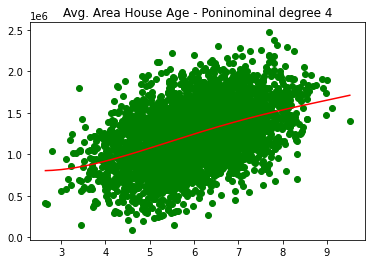

-------------------------------------
Avg. Area House Age
Train Score: 0.19927370298869507
MAE: 250918.38516998524


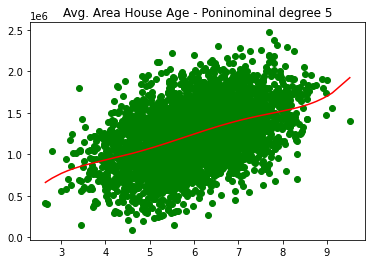

-------------------------------------
Avg. Area House Age
Train Score: 0.20016848225728534
MAE: 250679.00859278312


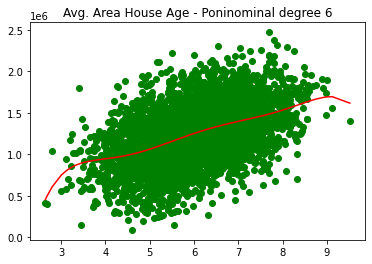

-------------------------------------
Avg. Area House Age
Train Score: 0.20084821653159457
MAE: 250463.49306761418


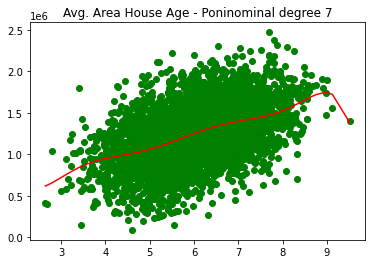

-------------------------------------
Avg. Area House Age
Train Score: 0.20093573768379758
MAE: 250439.03392385683


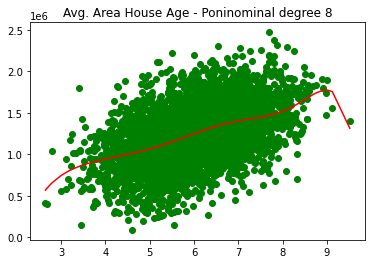

-------------------------------------
Avg. Area House Age
Train Score: 0.20175385148462976
MAE: 250221.98942735736


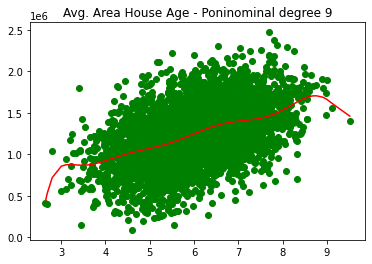

-------------------------------------
Avg. Area House Age
Train Score: 0.20207661983520486
MAE: 250194.83543983375


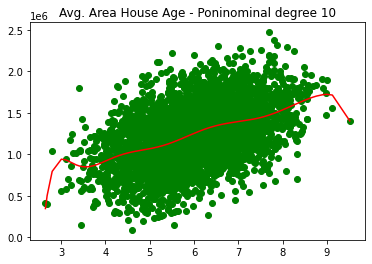

[0.19843096574897068, 0.198788895071215, 0.1988409466541553, 0.19927370298869507, 0.20016848225728534, 0.20084821653159457, 0.20093573768379758, 0.20175385148462976, 0.20207661983520486]
-------------------------------------
Avg. Area Number of Rooms
Train Score: 0.1091709494790144
MAE: 267894.2777482875


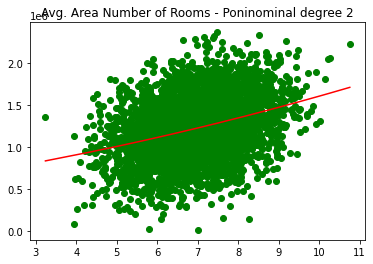

-------------------------------------
Avg. Area Number of Rooms
Train Score: 0.10971448974205233
MAE: 267849.1633941413


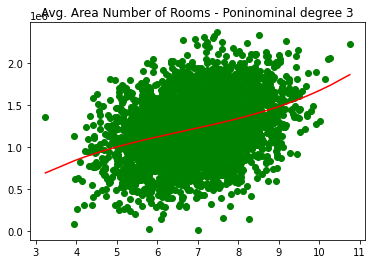

-------------------------------------
Avg. Area Number of Rooms
Train Score: 0.11000860910757437
MAE: 267801.37005111494


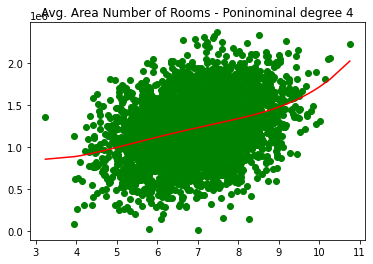

-------------------------------------
Avg. Area Number of Rooms
Train Score: 0.11001130321952735
MAE: 267796.63833821897


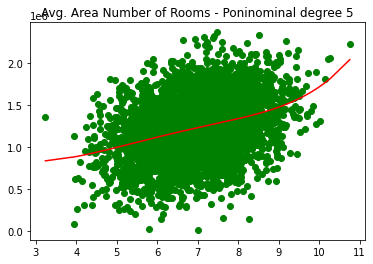

-------------------------------------
Avg. Area Number of Rooms
Train Score: 0.11047942271447886
MAE: 267695.25335576053


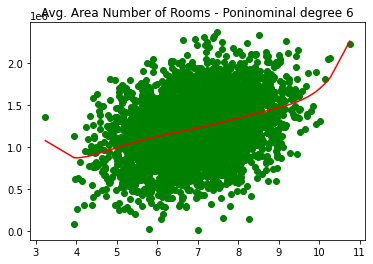

-------------------------------------
Avg. Area Number of Rooms
Train Score: 0.11049644554757299
MAE: 267683.47789147403


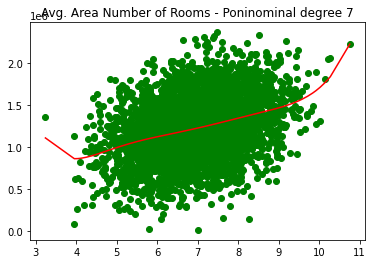

-------------------------------------
Avg. Area Number of Rooms
Train Score: 0.11124973685739825
MAE: 267616.25773621124


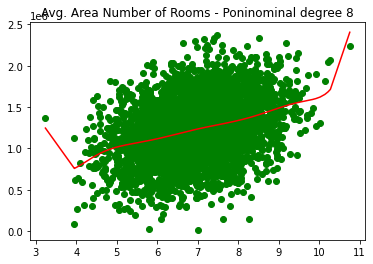

-------------------------------------
Avg. Area Number of Rooms
Train Score: 0.11252712091774986
MAE: 267303.26922197326


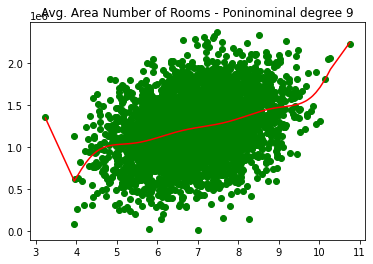

-------------------------------------
Avg. Area Number of Rooms
Train Score: 0.1125571820001452
MAE: 267333.67948740936


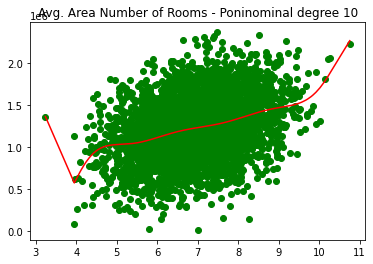

[0.1091709494790144, 0.10971448974205233, 0.11000860910757437, 0.11001130321952735, 0.11047942271447886, 0.11049644554757299, 0.11124973685739825, 0.11252712091774986, 0.1125571820001452]
-------------------------------------
Avg. Area Number of Bedrooms
Train Score: 0.029061823834341083
MAE: 278935.1070521071


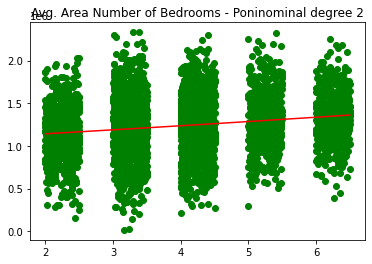

-------------------------------------
Avg. Area Number of Bedrooms
Train Score: 0.02912344131417577
MAE: 278913.3829596567


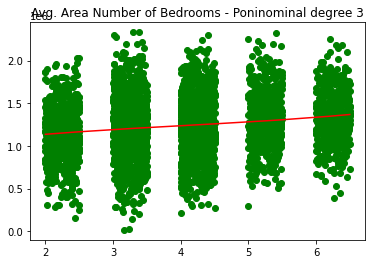

-------------------------------------
Avg. Area Number of Bedrooms
Train Score: 0.03308156999136869
MAE: 278235.78086400614


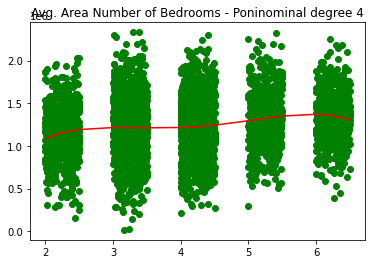

-------------------------------------
Avg. Area Number of Bedrooms
Train Score: 0.03318193193411456
MAE: 278230.28948653734


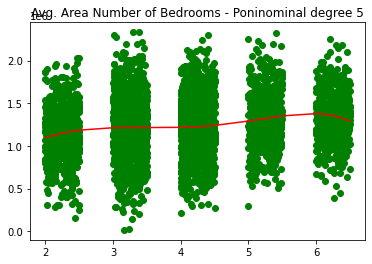

-------------------------------------
Avg. Area Number of Bedrooms
Train Score: 0.03510586967880136
MAE: 277910.6363154155


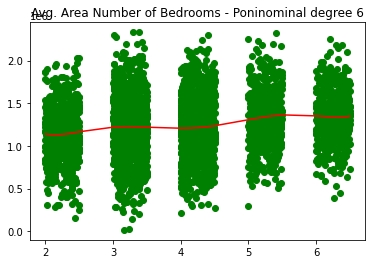

-------------------------------------
Avg. Area Number of Bedrooms
Train Score: 0.03521752642041831
MAE: 277893.2176269683


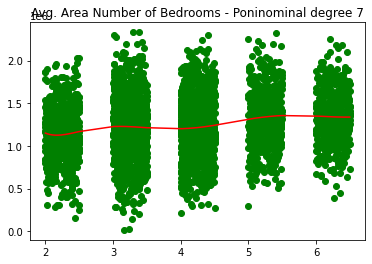

-------------------------------------
Avg. Area Number of Bedrooms
Train Score: 0.03521753100406011
MAE: 277893.5383564381


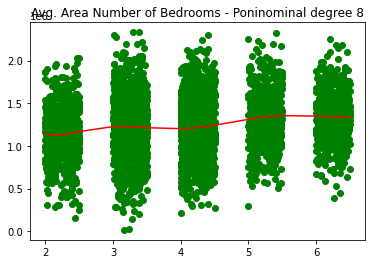

-------------------------------------
Avg. Area Number of Bedrooms
Train Score: 0.0352468117847482
MAE: 277894.62533937587


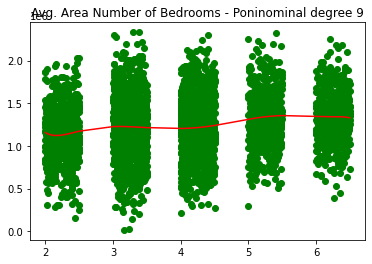

-------------------------------------
Avg. Area Number of Bedrooms
Train Score: 0.0355987246786269
MAE: 277845.6509387902


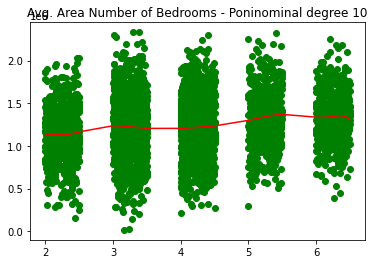

[0.029061823834341083, 0.02912344131417577, 0.03308156999136869, 0.03318193193411456, 0.03510586967880136, 0.03521752642041831, 0.03521753100406011, 0.0352468117847482, 0.0355987246786269]
-------------------------------------
Area Population
Train Score: 0.17277366506775615
MAE: 256075.11965441835


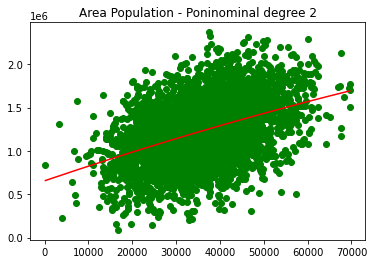

-------------------------------------
Area Population
Train Score: 0.1728159564125441
MAE: 256078.16484814213


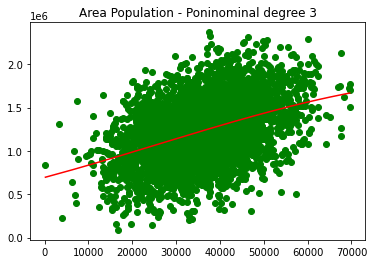

-------------------------------------
Area Population
Train Score: 0.17280261357157034
MAE: 256053.83158462105


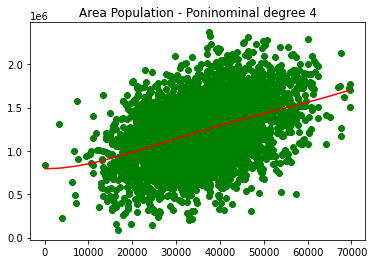

-------------------------------------
Area Population
Train Score: 0.17207082396481777
MAE: 256156.57431411569


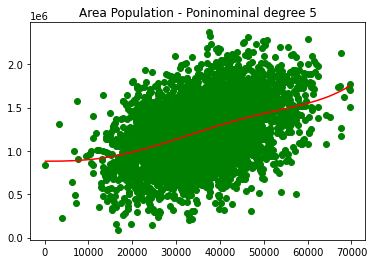

-------------------------------------
Area Population
Train Score: 0.17007598981700134
MAE: 256441.38539234054


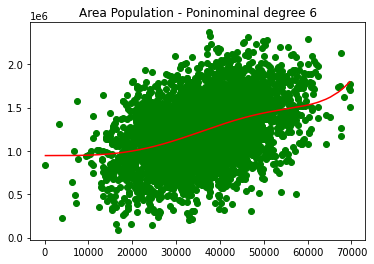

-------------------------------------
Area Population
Train Score: 0.1664992393893434
MAE: 256996.13323959452


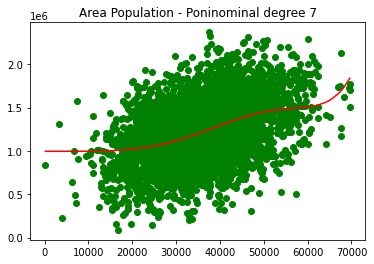

-------------------------------------
Area Population
Train Score: 0.16130833217042473
MAE: 257756.2042298369


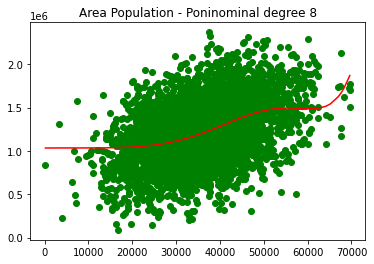

-------------------------------------
Area Population
Train Score: 0.15470437410752402
MAE: 258626.25747661412


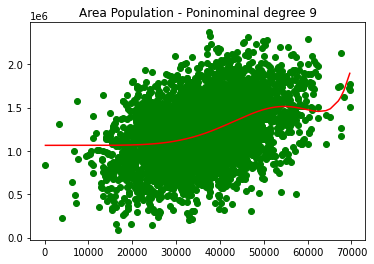

-------------------------------------
Area Population
Train Score: 0.14700055996488948
MAE: 259611.52139934545


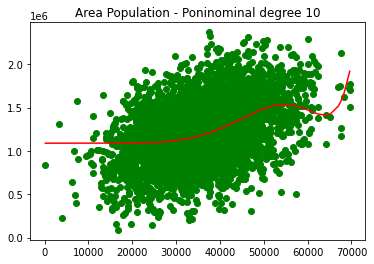

[0.17277366506775615, 0.1728159564125441, 0.17280261357157034, 0.17207082396481777, 0.17007598981700134, 0.1664992393893434, 0.16130833217042473, 0.15470437410752402, 0.14700055996488948]


In [5]:
non_linear_func(df)

In [ ]:
# Con todas las scores podemos ver como el score de cada columna se estanca más o menos en el grado 6

In [ ]:
# Si queremos ver si el modelo tiene overfitting o underfitting comparamos el score con cross-validation:

In [71]:
def overtraining_check(df):
    
    list_columns = df._get_numeric_data().columns.tolist()[:-1]
    
    for column in list_columns:
        
        X = df[[column]]

        # Test/train separación
        X_train, X_test, y_train, y_test = train_test_split(X.values, df["Price"].values, test_size=0.2)

        # Min and max grados a considerar
        degree_min = 2
        degree_max = 10

        scores = []
        train_scores = []
        for degree in range(degree_min,degree_max+1):
            polinominal_model = PolynomialFeatures(degree) 
            X_poly = polinominal_model.fit_transform(X_train.reshape(-1, 1),y_train)

            lin_reg_model = LinearRegression()
            lin_reg_model.fit(X_poly, y_train)
            y_pred = lin_reg_model.predict(X_poly)

            train_scores.append(r2_score(y_train, y_pred))

            # cross validation
            kfold = model_selection.KFold(n_splits=10, random_state=42, shuffle=True) 
            cv_results = model_selection.cross_val_score(lin_reg_model, X_train, y_train, cv=kfold)
            
        plt.plot(train_scores, color='red')
        plt.plot(cv_results, color='blue')
        plt.title(column)

        plt.show()

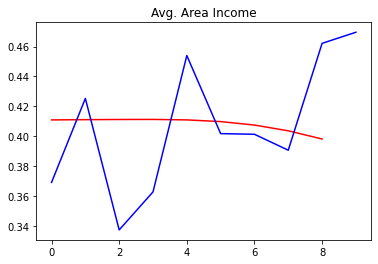

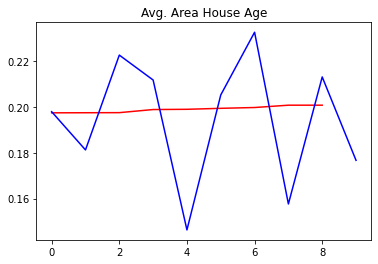

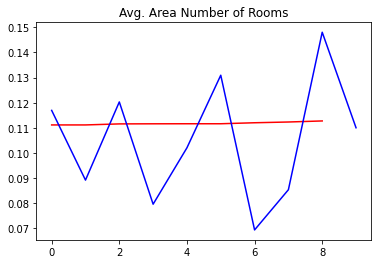

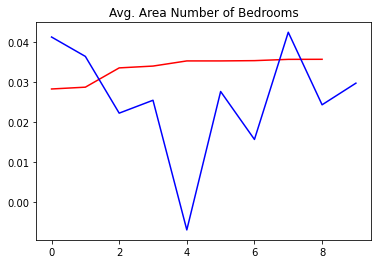

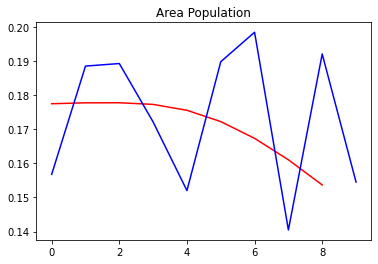

In [72]:
overtraining_check(df)

In [ ]:
# como el conjunto de validacion ha bajado (mientras train sube) por lo que hay sobre-entrenamiento